# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.78'

## Specifying filetype, and folder as before

In [2]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, filetype, prefix, prefix_str, file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [3]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong'). After selecting one, go through and select another one and run again from here. 
batch='Weak' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [4]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

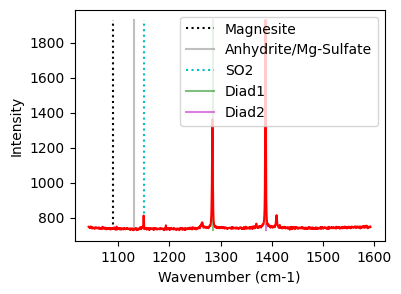

In [5]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [6]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [7]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250), upper_bck_diad1=(1300, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=629.4044256514553, HB_prom=37.603180724694425, x_range_baseline=30, y_range_baseline=100, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,HB1_Cent,HB1_Area,HB1_Sigma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_refit
0,1284.031599,1284.031649,0.005148,1559.705423,0.910326,0,1263.832316,199.918111,1.889927,629.551009,3.928495,0.676646,1.820652,Flagged Warnings:


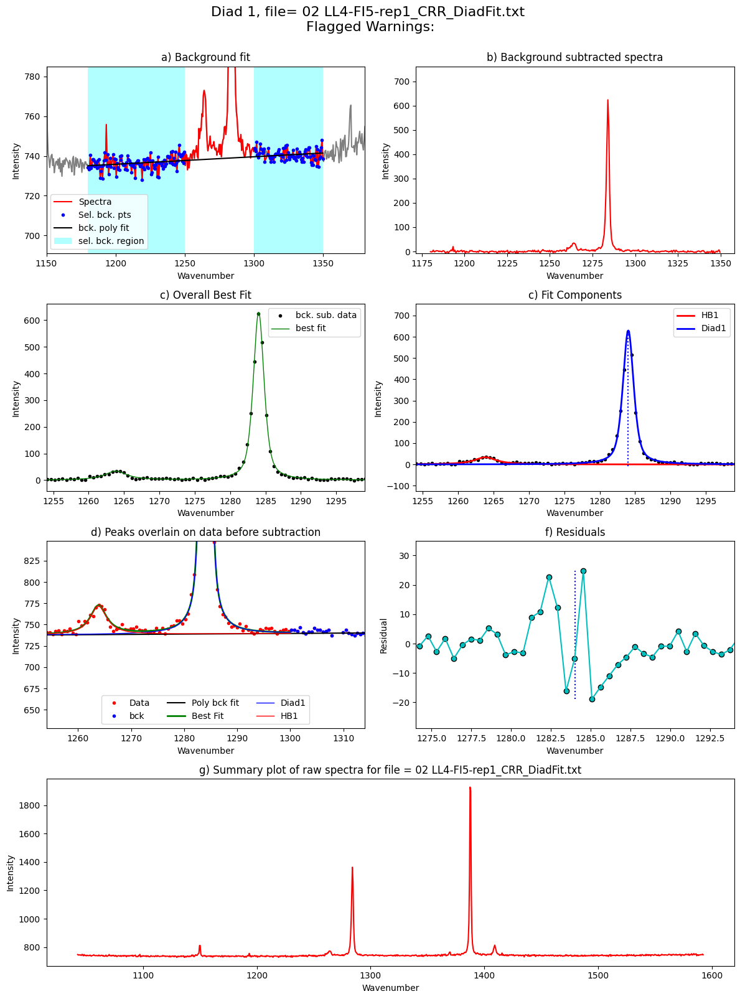

In [8]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [9]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [10]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1360), upper_bck_diad2=(1430, 1480), fit_gauss=False, gauss_amp=1000, diad_sigma=0.4, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=1292.0631537179493, HB_prom=73.26204666286469, x_range_baseline=30, y_range_baseline=100, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False, C13_prom=10)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,HB2_Cent,HB2_Area,HB2_Sigma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit
0,1387.736287,1387.736237,0.002199,2428.683081,0.644146,0,1409.117821,260.803577,1.18671,1352.283753,4.544697,0.733888,1.288292,Flagged Warnings:


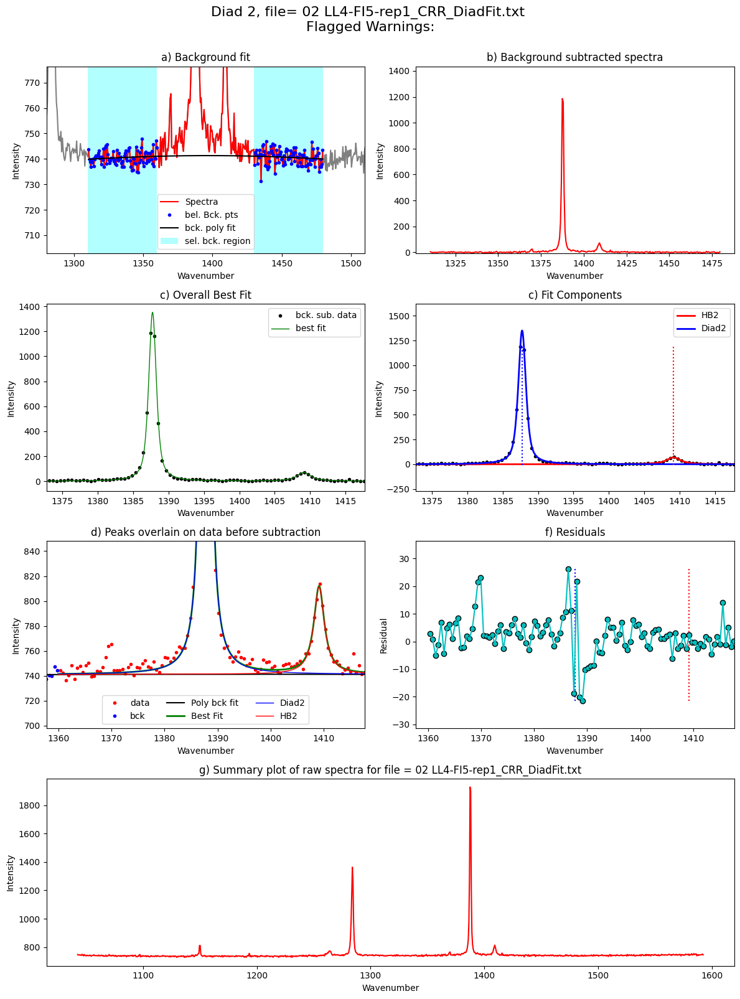

In [11]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/38 [00:00<?, ?it/s]

Processing file: 02 LL4-FI5-rep1_CRR_DiadFit.txt


  3%|▎         | 1/38 [00:02<01:25,  2.30s/it]

Processing file: 05 LL4-FI6.txt


  5%|▌         | 2/38 [00:04<01:19,  2.21s/it]

Processing file: 07 LL4-FI7-#1_CRR_DiadFit.txt


  8%|▊         | 3/38 [00:06<01:16,  2.20s/it]

Processing file: 09 LL4-FI7-#2.txt


 11%|█         | 4/38 [00:08<01:13,  2.17s/it]

Processing file: 11 LL4-FI7-#3-cosmicrays_CRR_DiadFit.txt


 13%|█▎        | 5/38 [00:10<01:09,  2.12s/it]

Processing file: 12 LL4-FI7-#3.txt


 16%|█▌        | 6/38 [00:12<01:04,  2.03s/it]

Processing file: 14 LL4-FI7-#4.txt


 18%|█▊        | 7/38 [00:14<01:02,  2.02s/it]

Processing file: 15 LL4-FI7-#5.txt


 21%|██        | 8/38 [00:16<01:00,  2.01s/it]

Processing file: 16 LL4-FI7-#6.txt


 24%|██▎       | 9/38 [00:18<00:57,  1.98s/it]

Processing file: 17 LL4-FI7-#7.txt


 26%|██▋       | 10/38 [00:20<00:56,  2.02s/it]c:\Users\charl\anaconda3\envs\pydev\Lib\site-packages\DiadFit\diads.py:2984: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))


Processing file: 18 LL4-FI7-#7-rep1.txt


 29%|██▉       | 11/38 [00:22<00:54,  2.00s/it]

Processing file: 20 LL4-FI7-#8_CRR_DiadFit.txt


 32%|███▏      | 12/38 [00:24<00:52,  2.04s/it]

Processing file: 21 LL4-FI7-#9.txt


 34%|███▍      | 13/38 [00:26<00:51,  2.06s/it]

Processing file: 22 LL4-FI7-#10.txt


 37%|███▋      | 14/38 [00:28<00:49,  2.06s/it]

Processing file: 23 LL4-FI7-#10-rep1.txt


 39%|███▉      | 15/38 [00:31<00:48,  2.11s/it]

Processing file: 25 LL4-FI7-#11_CRR_DiadFit.txt


 42%|████▏     | 16/38 [00:33<00:47,  2.14s/it]

Processing file: 26 LL4-FI7-#12cosmicray_CRR_DiadFit.txt


 45%|████▍     | 17/38 [00:35<00:46,  2.20s/it]

Processing file: 27 LL4-FI7-#12.txt


 47%|████▋     | 18/38 [00:37<00:43,  2.17s/it]

Processing file: 28 LL4-FI7-#13.txt


 50%|█████     | 19/38 [00:39<00:40,  2.12s/it]

Processing file: 29 LL4-FI8-#1cosmicratondiad_CRR_DiadFit.txt


 53%|█████▎    | 20/38 [00:42<00:38,  2.16s/it]

Processing file: 30 LL4-FI8-#1_CRR_DiadFit.txt


 55%|█████▌    | 21/38 [00:44<00:37,  2.21s/it]

Processing file: 32 LL4-FI9-#1.txt


 58%|█████▊    | 22/38 [00:47<00:38,  2.38s/it]

Processing file: 34 LL4-FI12dp.txt


 61%|██████    | 23/38 [00:49<00:35,  2.34s/it]

Processing file: 36 LL4-FI10-#1.txt


 63%|██████▎   | 24/38 [00:51<00:32,  2.32s/it]

Processing file: 37 LL4-FI10-#2_CRR_DiadFit.txt


 66%|██████▌   | 25/38 [00:54<00:30,  2.34s/it]

Processing file: 38 LL4-FI10-#3.txt


 68%|██████▊   | 26/38 [00:56<00:28,  2.37s/it]

Processing file: 39 LL4-FI10-#4.txt


 71%|███████   | 27/38 [00:59<00:27,  2.52s/it]

Processing file: 40 LL4-FI10-#5_CRR_DiadFit.txt


 74%|███████▎  | 28/38 [01:01<00:24,  2.44s/it]

Processing file: 42 LL4-FI10-#6_CRR_DiadFit.txt


 76%|███████▋  | 29/38 [01:03<00:21,  2.41s/it]

Processing file: 43 LL4-FI10-#7.txt


 79%|███████▉  | 30/38 [01:06<00:18,  2.30s/it]

Processing file: 44 LL4-FI10-#8.txt


 82%|████████▏ | 31/38 [01:08<00:16,  2.30s/it]

Processing file: 46 LL4-FI10-#9.txt


 84%|████████▍ | 32/38 [01:10<00:13,  2.26s/it]

Processing file: 47 LL4-FI10-#10_CRR_DiadFit.txt


 87%|████████▋ | 33/38 [01:12<00:10,  2.19s/it]

Processing file: 48 LL4-FI10-#11.txt


 89%|████████▉ | 34/38 [01:14<00:08,  2.19s/it]

Processing file: 49 LL4-FI10-#12.txt


 92%|█████████▏| 35/38 [01:17<00:07,  2.35s/it]

Processing file: 51 LL4-FI10-#13_CRR_DiadFit.txt


 95%|█████████▍| 36/38 [01:19<00:04,  2.32s/it]

Processing file: 52 LL4-FI12-#1_CRR_DiadFit.txt


 97%|█████████▋| 37/38 [01:21<00:02,  2.27s/it]

Processing file: 53 LL4-FI12-#2_CRR_DiadFit.txt


100%|██████████| 38/38 [01:24<00:00,  2.21s/it]


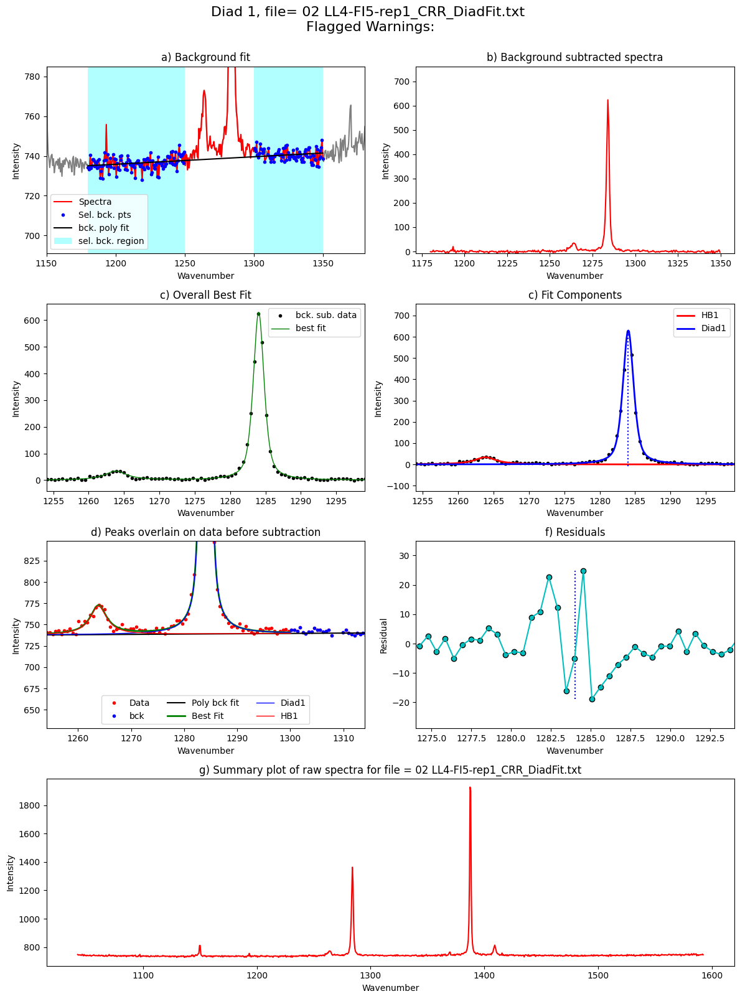

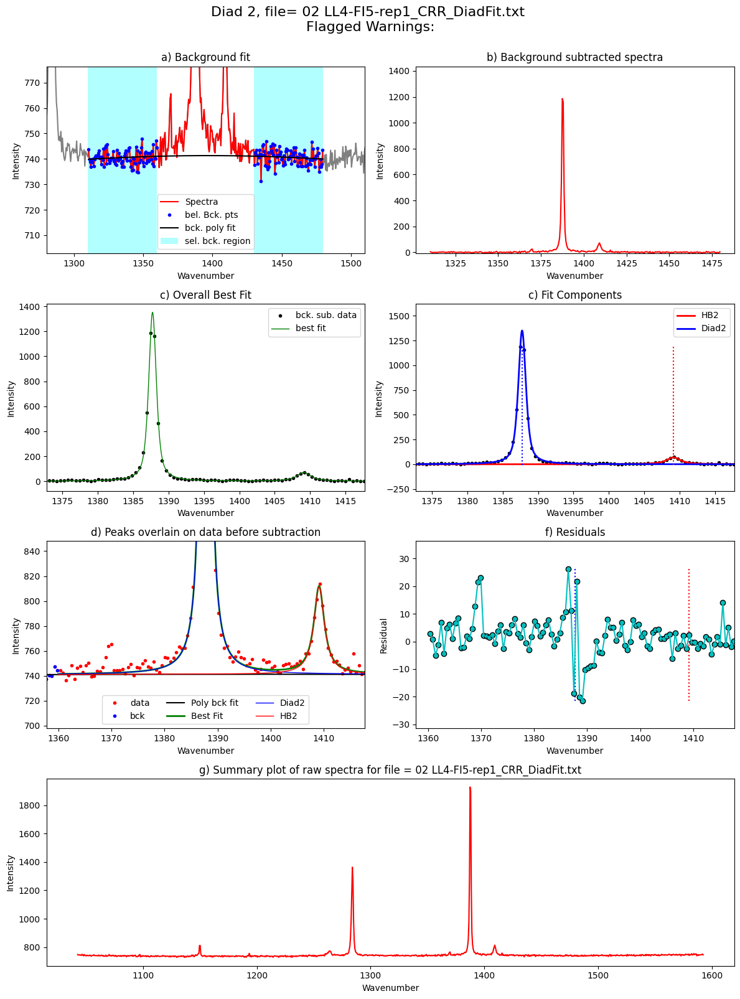

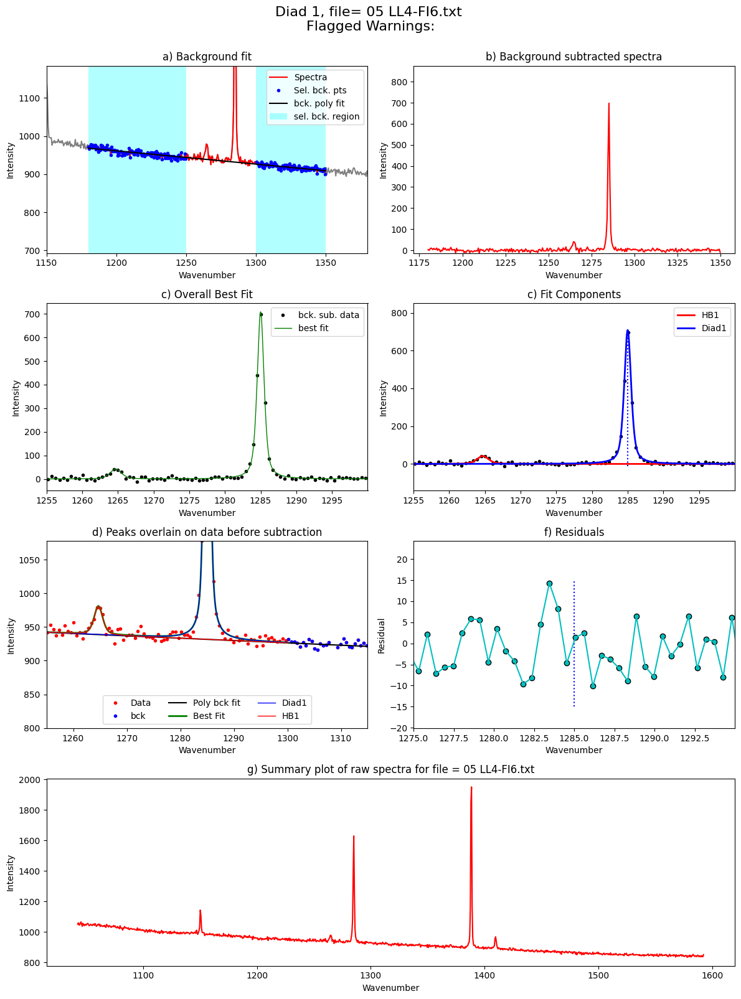

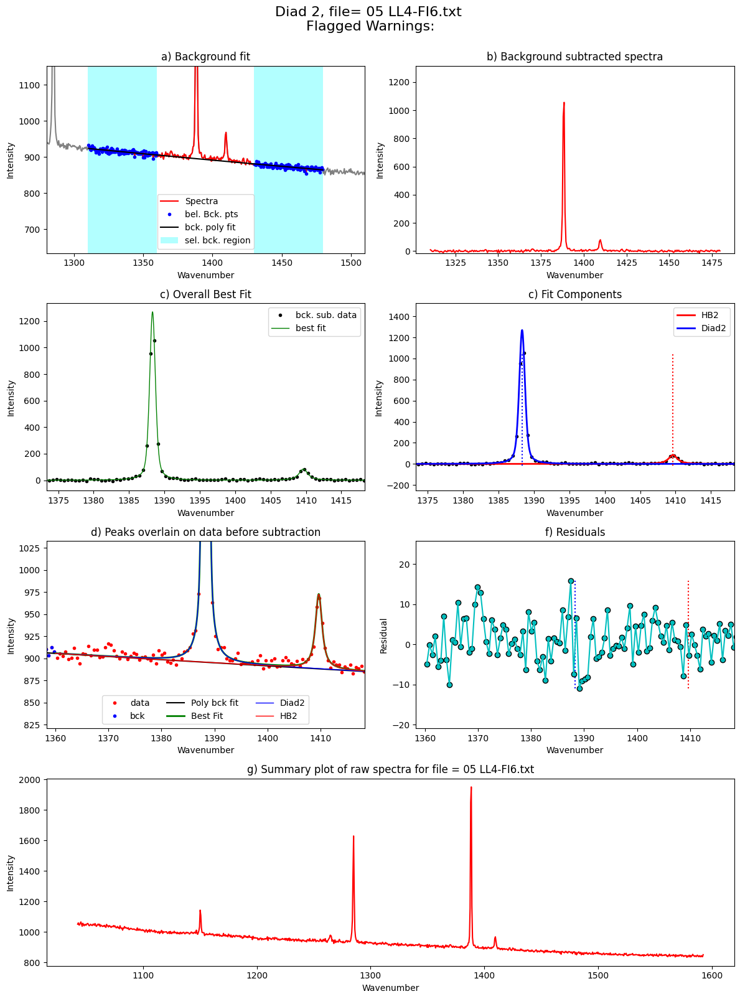

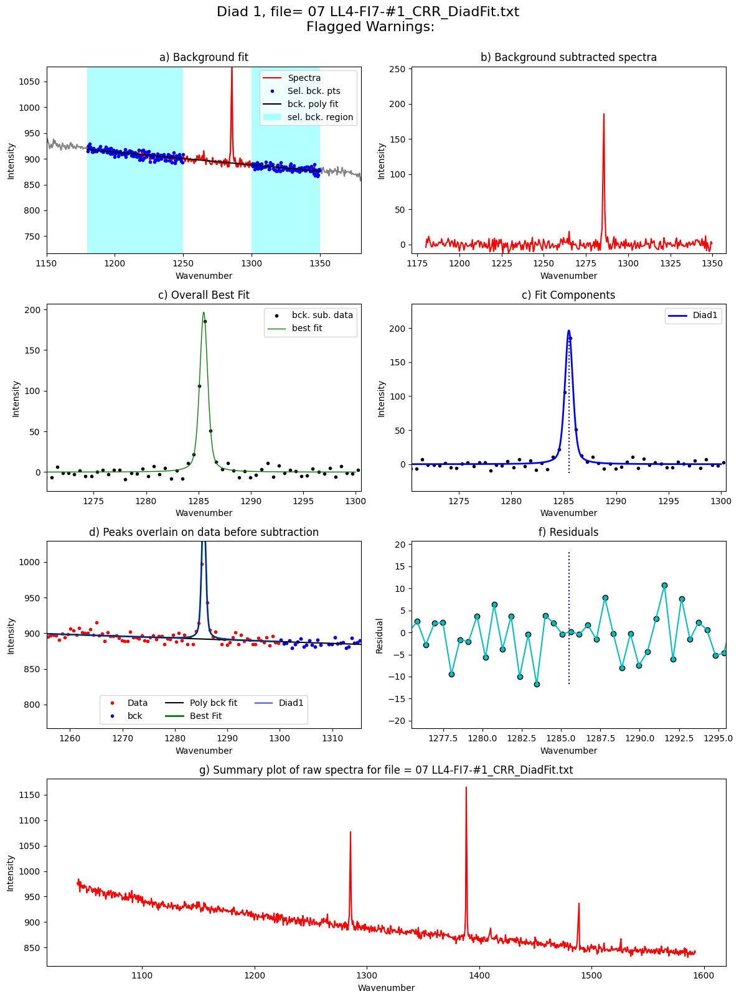

...

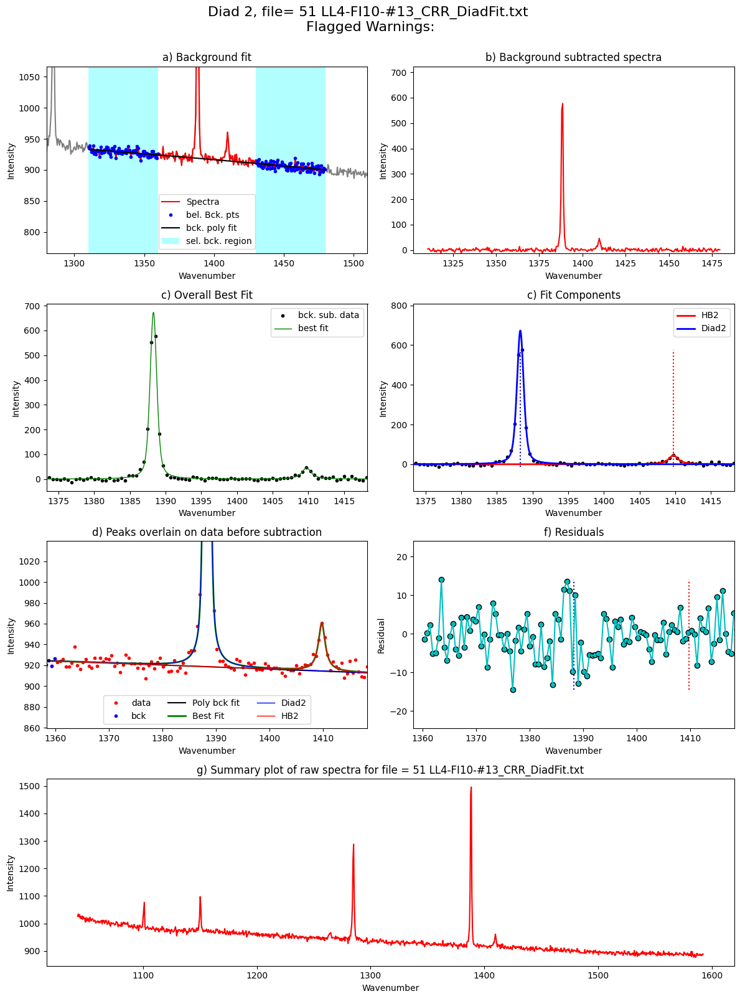

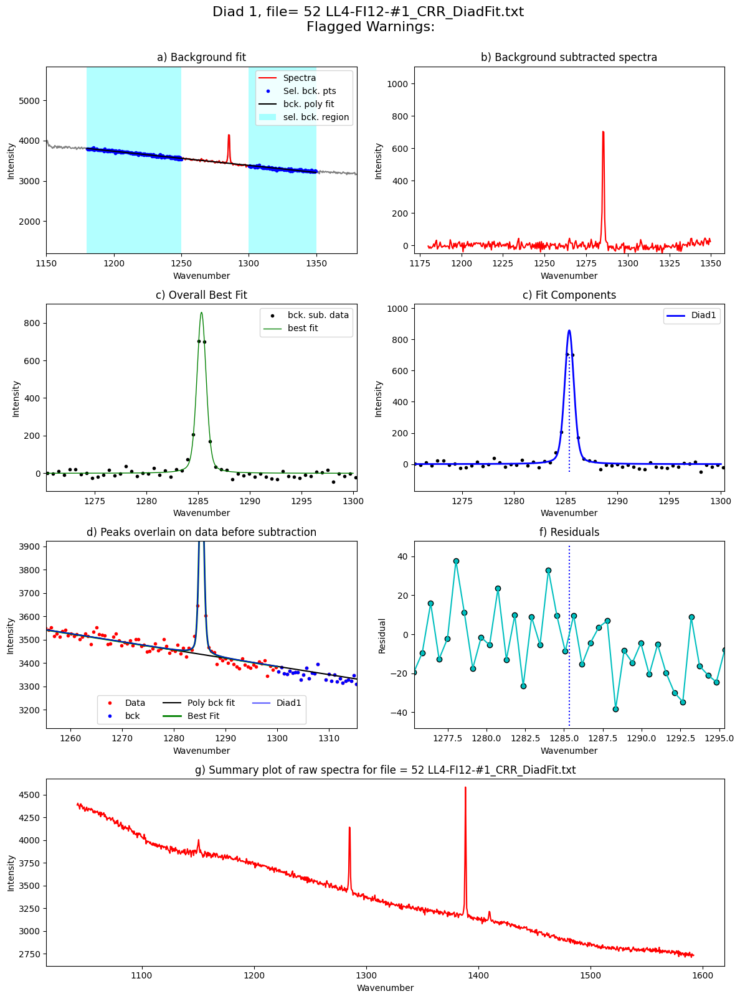

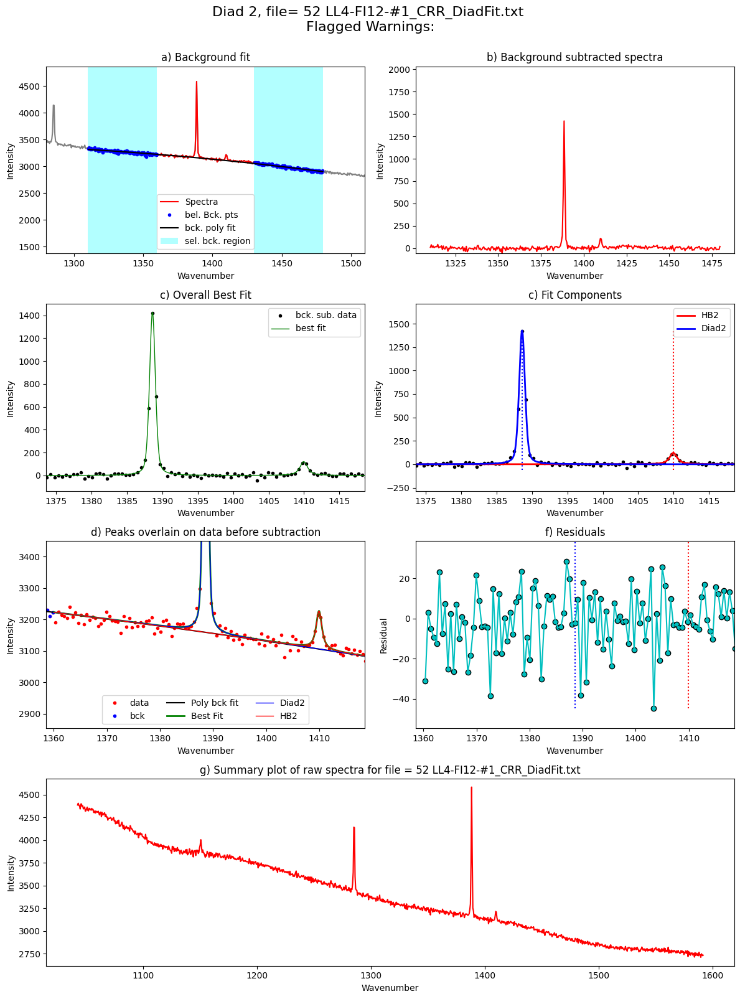

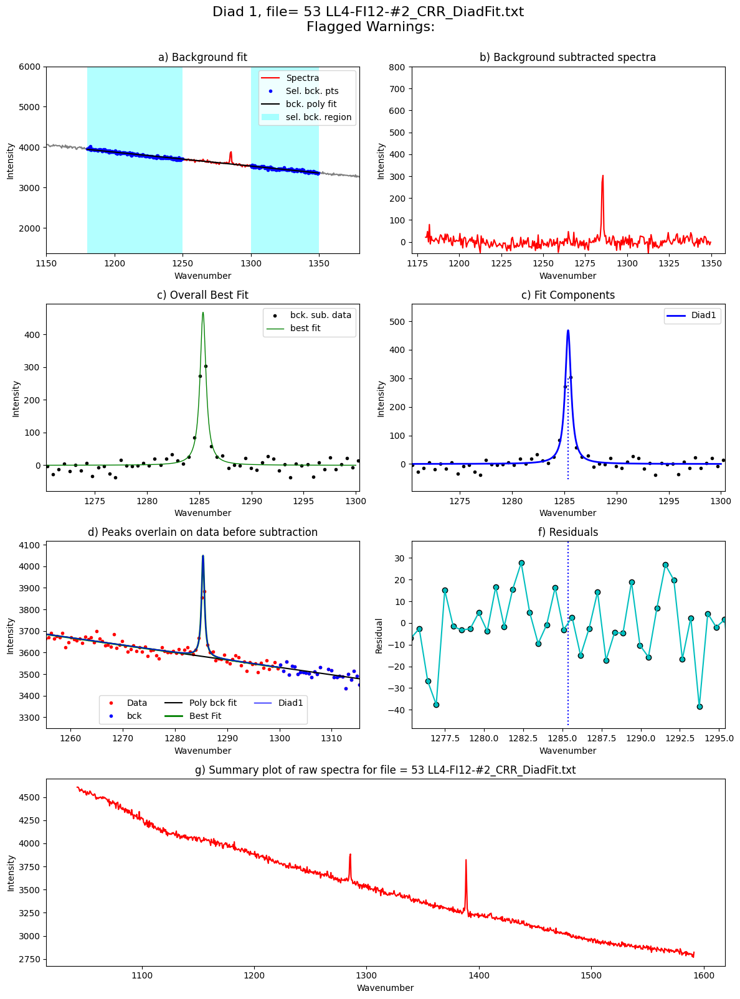

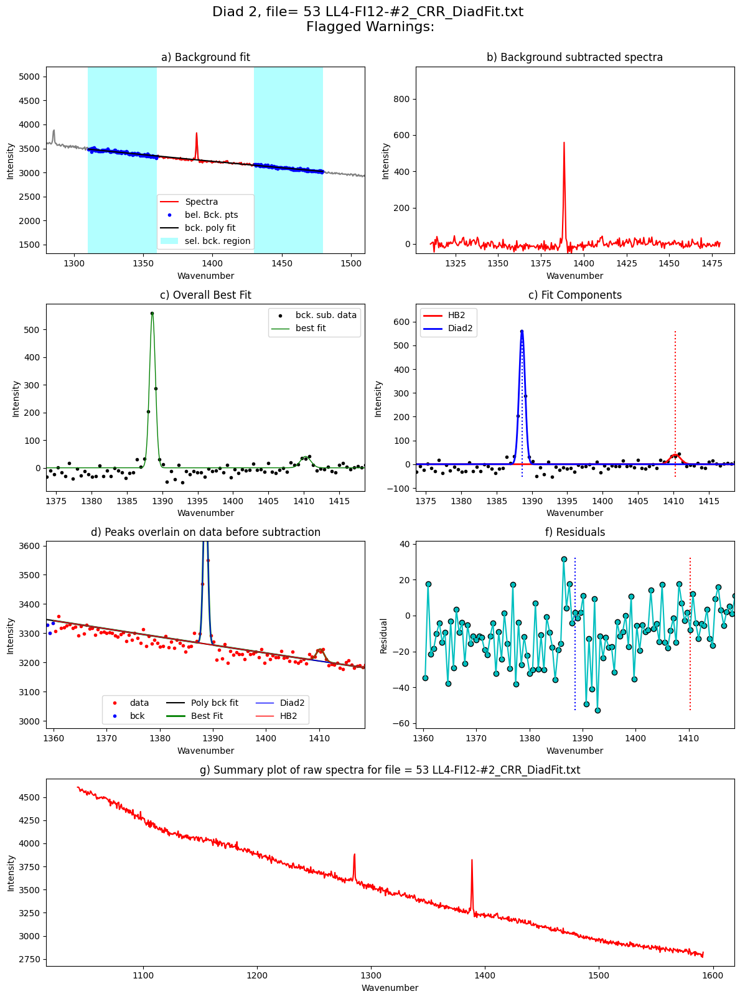

In [12]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [13]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [14]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,HB2_Sigma,C13_Cent,C13_Area,C13_Sigma,Diad2_Gauss_Cent,Diad2_Gauss_Area,Diad2_Gauss_Sigma,Diad1_Gauss_Cent,Diad1_Gauss_Area,Diad1_Gauss_Sigma
0,LL4-FI5-rep1_CRR_DiadFit,103.704588,0.005598,1284.031599,0.005148,629.551009,1284.031649,1559.705423,0.910326,3.928495,...,1.186710,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,LL4-FI6,103.322543,0.005281,1284.999416,0.004909,708.709163,1284.999466,1102.458889,0.576445,4.819073,...,0.752911,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,LL4-FI7-#1_CRR_DiadFit,103.203321,0.018028,1285.502744,0.015415,196.573271,1285.502744,227.007062,0.449657,3.849392,...,0.491918,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,LL4-FI7-#2,103.177872,0.009008,1285.508380,0.007889,201.257452,1285.508380,236.078207,0.468483,2.375790,...,0.503071,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,LL4-FI7-#3-cosmicrays_CRR_DiadFit,103.120422,0.016265,1285.561558,0.013768,128.965173,1285.561558,146.370115,0.466035,2.535906,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,LL4-FI7-#3,103.120305,0.016916,1285.551704,0.015228,128.210066,1285.551704,146.708412,0.437432,2.482328,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,LL4-FI7-#4,103.157662,0.009257,1285.514250,0.007665,194.677541,1285.514250,234.378541,0.476191,2.204494,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,LL4-FI7-#5,103.163562,0.003316,1285.535184,0.002884,432.816712,1285.535234,522.787311,0.466976,1.363902,...,0.497058,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,LL4-FI7-#6,103.161588,0.007937,1285.551525,0.007207,200.748570,1285.551525,238.498166,0.477246,1.968911,...,0.529038,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,LL4-FI7-#7,103.214418,0.074870,1285.530148,0.066474,28.138651,1285.530148,31.435419,0.530216,2.539093,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### This plays a sound when the notebook is done if you have a tendency to procrastinate

In [1]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()